Welcome to my notebook! This is a copy/paste welcome message for all my notebooks :) 📓 This repository/notebook serves as a personal reminder for me, documenting code snippets and techniques sourced from various learning resources. The goal is to consolidate valuable information and create a basic reference guide. Please note that the codes included here are not originally mine, and credit goes to the respective authors and resources. Feel free to explore and use this collection as a shared learning space. Happy coding

#### Sources for this notebook : 
    * https://huggingface.co/docs/diffusers/using-diffusers/other-formats
    * https://huggingface.co/docs/diffusers/using-diffusers/loading_adapters
    * https://huggingface.co/docs/diffusers/en/api/pipelines/animatediff
    
    
#### Purpose :
    * loading LoRA from Civit
    * Using different adapters
    
#### Keywords :
    * text-inversion 
    * adapters
    * LoRA
    * Dreambooth
    * IP-adapter
    * PEFT

In [1]:
from diffusers import StableDiffusionXLPipeline
import torch

pipeline = StableDiffusionXLPipeline.from_pretrained(
    "Lykon/dreamshaper-xl-1-0", torch_dtype=torch.float16, variant="fp16"
).to("cuda")

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
text_encoder_2/config.json: 100%|██████████| 741/741 [00:00<00:00, 185kB/s]

scheduler/scheduler_config.json: 100%|██████████| 648/648 [00:00<00:00, 162kB/s]

tokenizer/tokenizer_config.json:   0%|       

In [2]:
pipeline

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.26.2",
  "_name_or_path": "Lykon/dreamshaper-xl-1-0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "DEISMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [3]:
pipeline.load_lora_weights(".", weight_name="bl3uprint.safetensors")

In [4]:
pipeline

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.26.2",
  "_name_or_path": "Lykon/dreamshaper-xl-1-0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "DEISMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [5]:
generator = torch.Generator(device="cuda").manual_seed(0)

  0%|          | 0/50 [00:00<?, ?it/s]C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\models\attention_processor.py:1244: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  hidden_states = F.scaled_dot_product_attention(
100%|██████████| 50/50 [31:11<00:00, 37.43s/it]


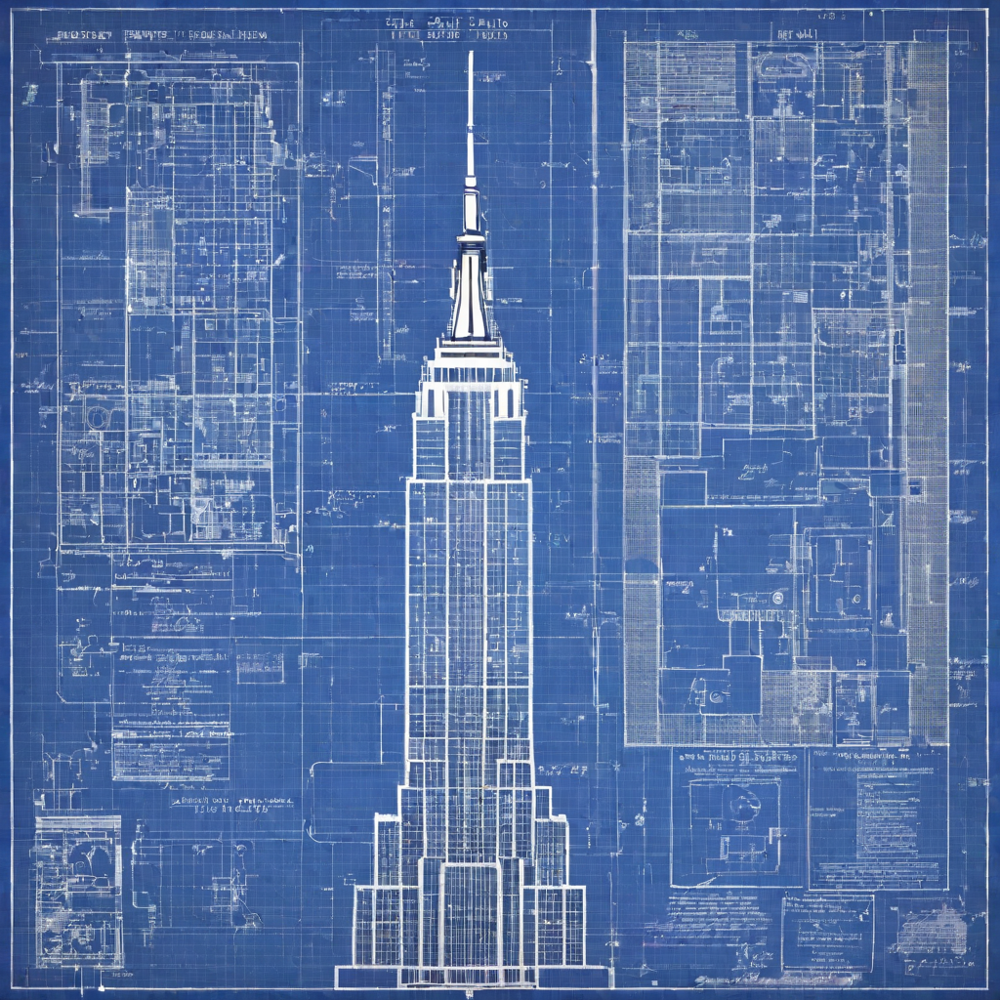

In [6]:
prompt = "bl3uprint, a highly detailed blueprint of the empire state building, explaining how to build all parts, many txt, blueprint grid backdrop"
negative_prompt = "lowres, cropped, worst quality, low quality, normal quality, artifacts, signature, watermark, username, blurry, more than one bridge, bad architecture"

image = pipeline(
    prompt=prompt,
    negative_prompt=negative_prompt,
    generator=generator,
).images[0]
image

In [7]:
image.save('blue.png')

### DreamBooth

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
model_index.json: 100%|██████████| 546/546 [00:00<00:00, 179kB/s]
vae\diffusion_pytorch_model.safetensors not found
tokenizer/special_tokens_map.json: 100%|██████████| 472/472 [00:00<00:00, 81.6kB/s]

tex

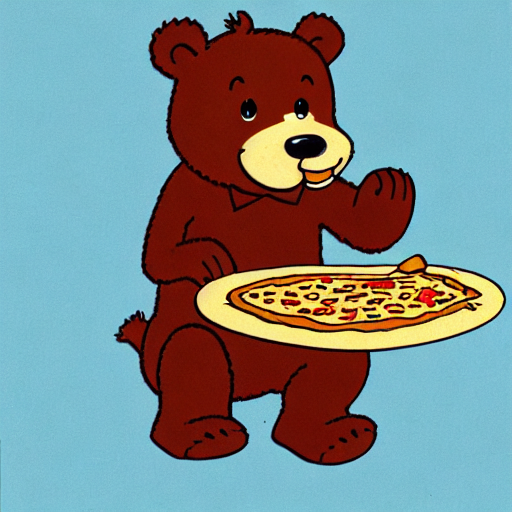

In [1]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline = AutoPipelineForText2Image.from_pretrained("sd-dreambooth-library/herge-style", torch_dtype=torch.float16).to("cuda")
prompt = "A cute herge_style brown bear eating a slice of pizza, stunning color scheme, masterpiece, illustration"
image = pipeline(prompt).images[0]
image

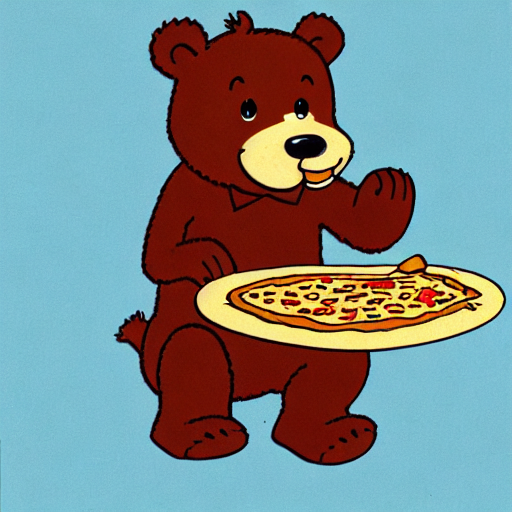

In [2]:
image

100%|██████████| 50/50 [00:08<00:00,  6.02it/s]


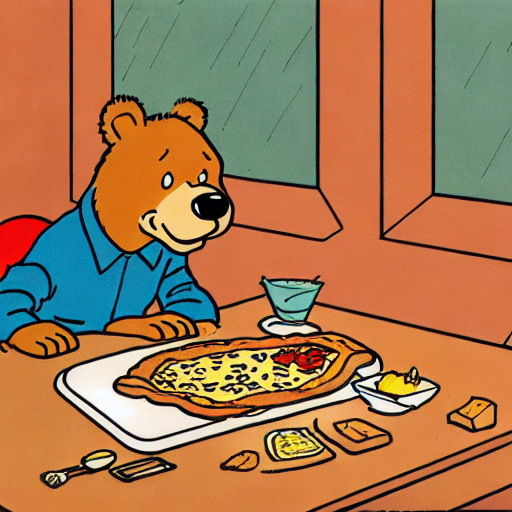

In [3]:
prompt = "A cute sks herge_style brown bear eating a slice of pizza, stunning color scheme, masterpiece, illustration"
image = pipeline(prompt).images[0]
image

### TEXT-INVERSION

In [4]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline = AutoPipelineForText2Image.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16).to("cuda")

Loading pipeline components...: 100%|██████████| 7/7 [00:08<00:00,  1.27s/it]


learned_embeds.bin: 100%|██████████| 3.82k/3.82k [00:00<00:00, 1.27MB/s]
100%|██████████| 50/50 [00:08<00:00,  6.03it/s]


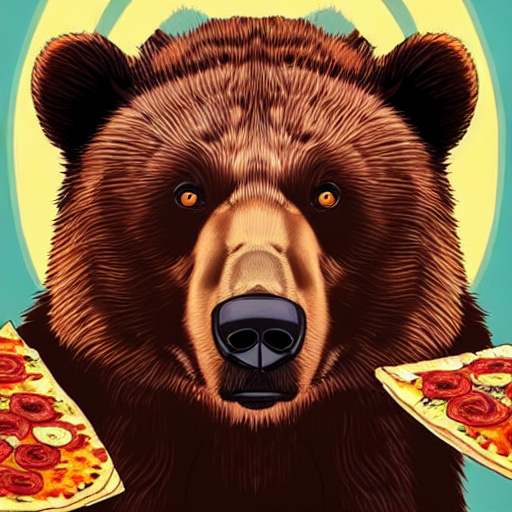

In [5]:
pipeline.load_textual_inversion("sd-concepts-library/gta5-artwork")
prompt = "A cute brown bear eating a slice of pizza, stunning color scheme, masterpiece, illustration, <gta5-artwork> style"
image = pipeline(prompt).images[0]
image

### LORA

In [1]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline = AutoPipelineForText2Image.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16).to("cuda")

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
Loading pipeline components...: 100%|██████████| 7/7 [00:05<00:00,  1.39it/s]


  0%|          | 0/50 [00:00<?, ?it/s]C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\models\attention_processor.py:1244: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  hidden_states = F.scaled_dot_product_attention(
100%|██████████| 50/50 [34:25<00:00, 41.32s/it]


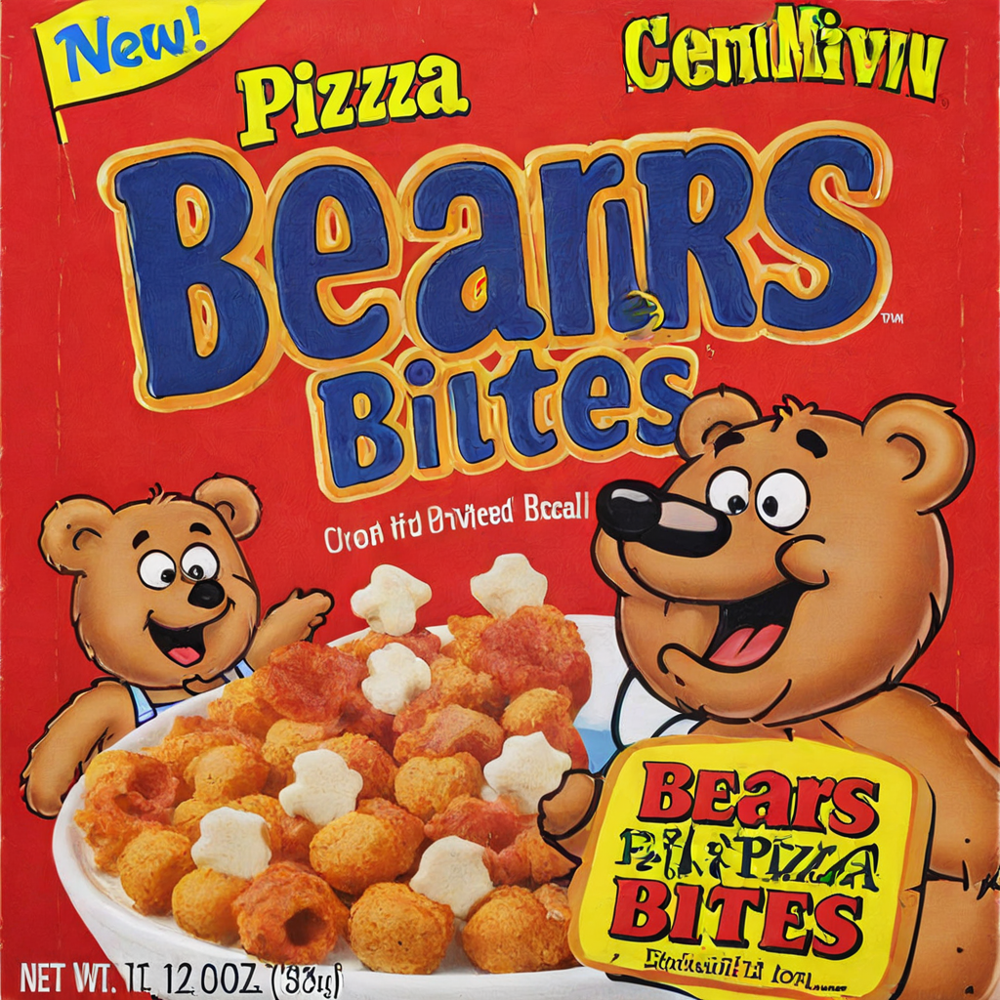

In [2]:
pipeline.load_lora_weights("ostris/super-cereal-sdxl-lora", weight_name="cereal_box_sdxl_v1.safetensors")
prompt = "bears, pizza bites"
image = pipeline(prompt).images[0]
image

In [ ]:
pipeline.unload_lora_weights()

### Load multiple lora

In [1]:
from diffusers import StableDiffusionXLPipeline, AutoencoderKL
import torch

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipeline = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    torch_dtype=torch.float16,
).to("cuda")

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
config.json: 100%|██████████| 631/631 [00:00<00:00, 210kB/s]
diffusion_pytorch_model.safetensors: 100%|██████████| 335M/335M [00:58<00:00, 5.77MB/s] 
Loading pipeline components...: 100%|██████████| 7/7 [

In [2]:
pipeline.load_lora_weights("ostris/ikea-instructions-lora-sdxl")
pipeline.fuse_lora(lora_scale=0.7)

# to unfuse the LoRA weights
pipeline.unfuse_lora()

ikea_instructions_xl_v1_5.safetensors: 100%|██████████| 186M/186M [00:34<00:00, 5.33MB/s] 


In [3]:
pipeline.load_lora_weights("ostris/super-cereal-sdxl-lora")
pipeline.fuse_lora(lora_scale=0.7)

  0%|          | 0/50 [00:00<?, ?it/s]C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\models\attention_processor.py:1244: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:263.)
  hidden_states = F.scaled_dot_product_attention(
100%|██████████| 50/50 [29:11<00:00, 35.02s/it]


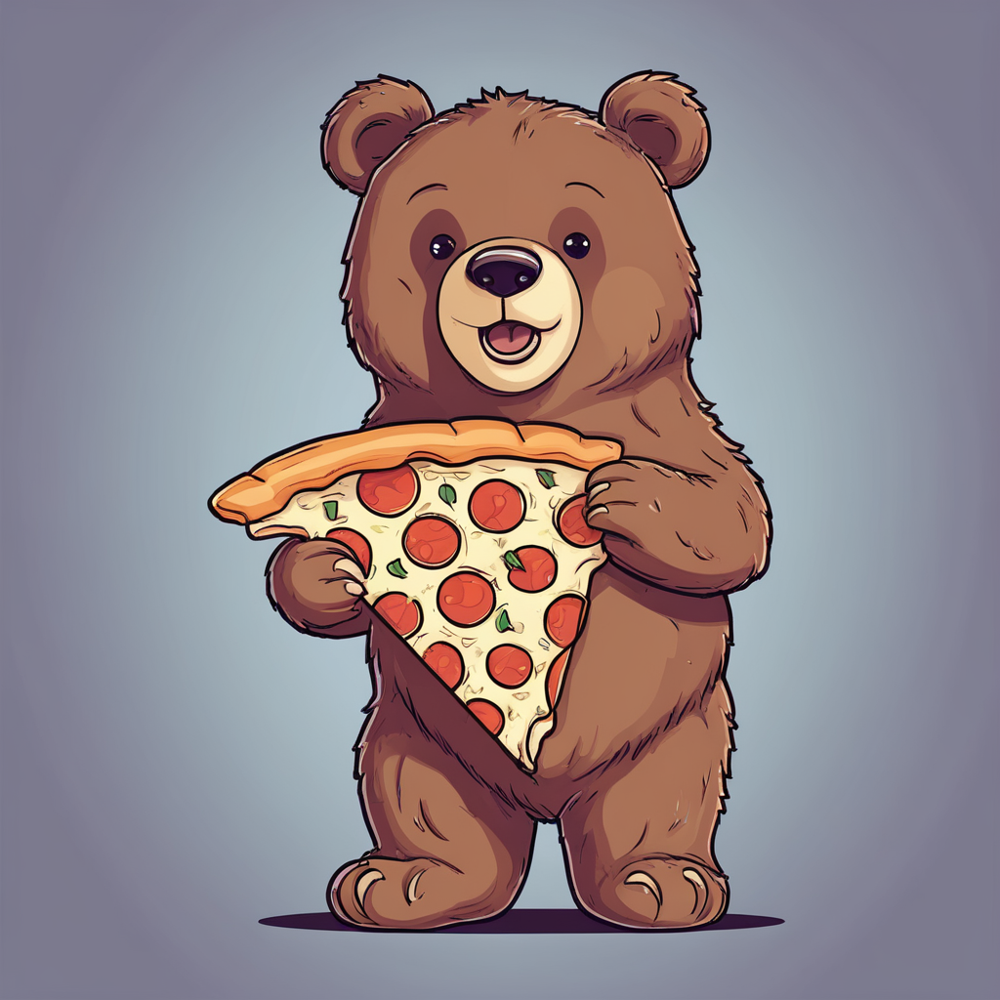

In [4]:
prompt = "A cute brown bear eating a slice of pizza, stunning color scheme, masterpiece, illustration"
image = pipeline(prompt).images[0]
image

### PEFT

In [5]:
from diffusers import DiffusionPipeline
import torch

pipeline = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16).to("cuda")
pipeline.load_lora_weights("ostris/ikea-instructions-lora-sdxl", weight_name="ikea_instructions_xl_v1_5.safetensors", adapter_name="ikea")
pipeline.load_lora_weights("ostris/super-cereal-sdxl-lora", weight_name="cereal_box_sdxl_v1.safetensors", adapter_name="cereal")

Loading pipeline components...: 100%|██████████| 7/7 [00:15<00:00,  2.16s/it]


In [6]:
pipeline.set_adapters(["ikea", "cereal"], adapter_weights=[0.7, 0.5])

100%|██████████| 30/30 [07:34<00:00, 15.16s/it]


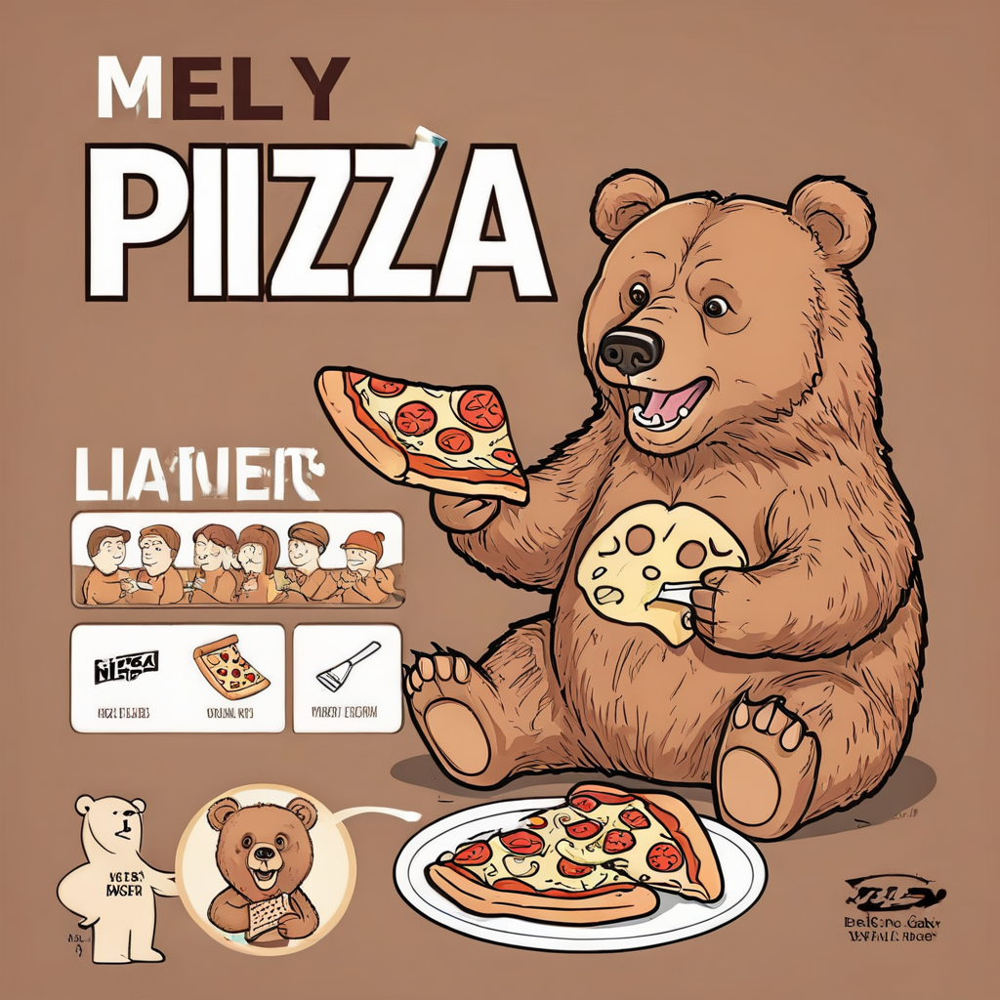

In [7]:
prompt = "A cute brown bear eating a slice of pizza, stunning color scheme, masterpiece, illustration"
image = pipeline(prompt, num_inference_steps=30, cross_attention_kwargs={"scale": 1.0}).images[0]
image

### IP-ADAPTER

In [8]:
from diffusers import AutoPipelineForText2Image
import torch
from diffusers.utils import load_image


pipeline = AutoPipelineForText2Image.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16).to("cuda")

Loading pipeline components...: 100%|██████████| 7/7 [00:10<00:00,  1.52s/it]


In [9]:
pipeline.load_ip_adapter("h94/IP-Adapter", subfolder="models", weight_name="ip-adapter_sd15.bin")

ip-adapter_sd15.bin: 100%|██████████| 44.6M/44.6M [00:08<00:00, 5.09MB/s]
models/image_encoder/config.json: 100%|██████████| 560/560 [00:00<00:00, 187kB/s]
model.safetensors: 100%|██████████| 2.53G/2.53G [07:26<00:00, 5.66MB/s]


100%|██████████| 50/50 [01:47<00:00,  2.14s/it]


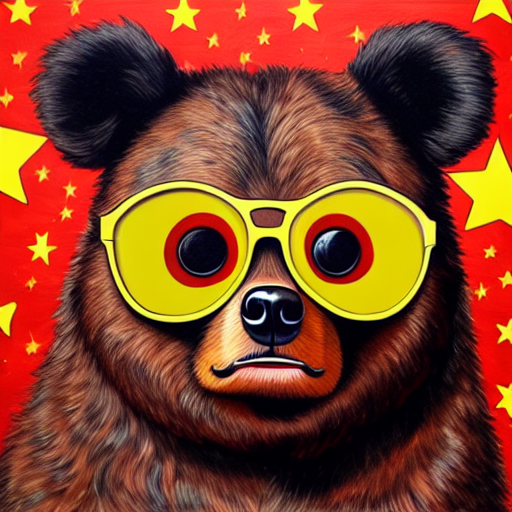

In [14]:
pipeline.set_ip_adapter_scale(0.6)
image = load_image("https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/load_neg_embed.png")
generator = torch.Generator(device="cpu").manual_seed(33)
images = pipeline(prompt='best quality, high quality, wearing sunglasses',ip_adapter_image=image,negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",
num_inference_steps=50,generator=generator).images
images[0]

İMAGETOIMAGE

100%|██████████| 30/30 [00:58<00:00,  1.95s/it]


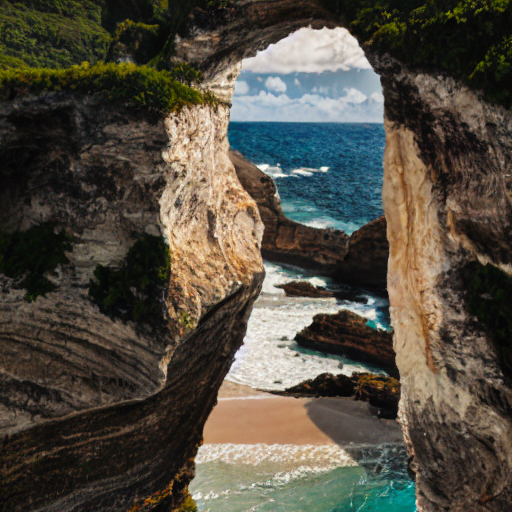

In [15]:
from diffusers import AutoPipelineForImage2Image
import torch
from diffusers.utils import load_image

pipeline = AutoPipelineForImage2Image.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16).to("cuda")

image = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/vermeer.jpg")
ip_image = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/river.png")

pipeline.load_ip_adapter("h94/IP-Adapter", subfolder="models", weight_name="ip-adapter_sd15.bin")
generator = torch.Generator(device="cuda").manual_seed(33)
images = pipeline(prompt='best quality, high quality',image = image,ip_adapter_image=ip_image,num_inference_steps=50,generator=generator,strength=0.6).images
images[0]

### FACES

In [23]:
import torch
from diffusers import StableDiffusionPipeline, DDIMScheduler
from diffusers.utils import load_image

pipeline = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16,safety_checker = None
).to("cuda")
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.load_ip_adapter("h94/IP-Adapter", subfolder="models", weight_name="ip-adapter-full-face_sd15.bin")

pipeline.set_ip_adapter_scale(0.7)

image = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/ai_face2.png")

generator = torch.Generator(device="cuda").manual_seed(33)

image = pipeline(prompt="A photo of a girl wearing a black dress, holding red roses in hand, upper body, behind is the Eiffel Tower",ip_adapter_image=image,negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality",num_inference_steps=50, num_images_per_prompt=1, width=512, height=704,generator=generator).images[0]

Loading pipeline components...: 100%|██████████| 6/6 [00:08<00:00,  1.35s/it]
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .
100%|██████████| 50/50 [00:11<00:00,  4.23it/s]


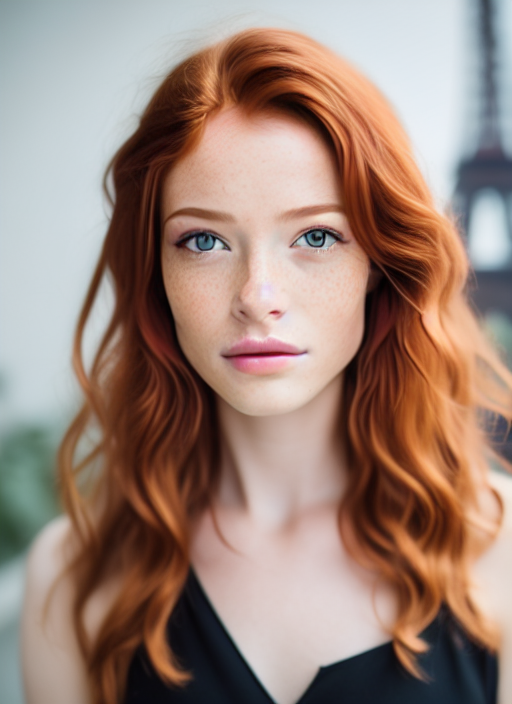

In [24]:
image

### MULTIPLE IP-ADAPTER

In [17]:
import torch
from diffusers import AutoPipelineForText2Image, DDIMScheduler
from transformers import CLIPVisionModelWithProjection
from diffusers.utils import load_image

image_encoder = CLIPVisionModelWithProjection.from_pretrained(
    "h94/IP-Adapter", 
    subfolder="models/image_encoder",
    torch_dtype=torch.float16,
)

pipeline = AutoPipelineForText2Image.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    image_encoder=image_encoder,
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline.load_ip_adapter(
  "h94/IP-Adapter", 
  subfolder="sdxl_models", 
  weight_name=["ip-adapter-plus_sdxl_vit-h.safetensors", "ip-adapter-plus-face_sdxl_vit-h.safetensors"]
)
pipeline.set_ip_adapter_scale([0.7, 0.3])
pipeline.enable_model_cpu_offload()

face_image = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/women_input.png")
style_folder = "https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/style_ziggy"
style_images =  [load_image(f"{style_folder}/img{i}.png") for i in range(10)]

generator = torch.Generator(device="cpu").manual_seed(0)

image = pipeline(
    prompt="wonderwoman",
    ip_adapter_image=[style_images, face_image],
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality", 
    num_inference_steps=50, num_images_per_prompt=1,
    generator=generator,
).images[0]

Loading pipeline components...: 100%|██████████| 7/7 [00:22<00:00,  3.23s/it]
ip-adapter-plus_sdxl_vit-h.safetensors: 100%|██████████| 848M/848M [02:27<00:00, 5.75MB/s] 
(…)adapter-plus-face_sdxl_vit-h.safetensors: 100%|██████████| 848M/848M [02:29<00:00, 5.68MB/s] 
100%|██████████| 50/50 [02:20<00:00,  2.82s/it]


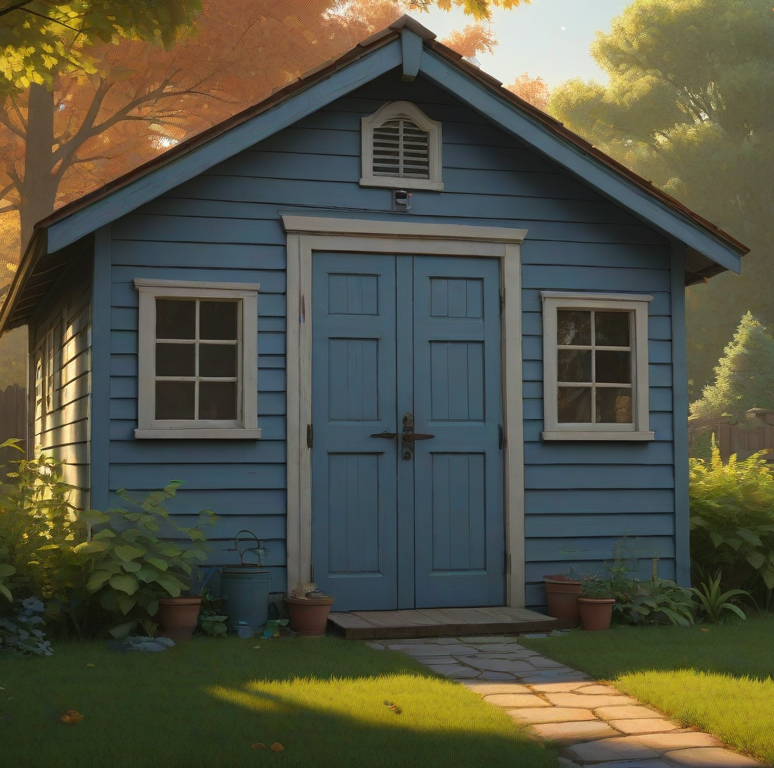

In [21]:
style_images[0]

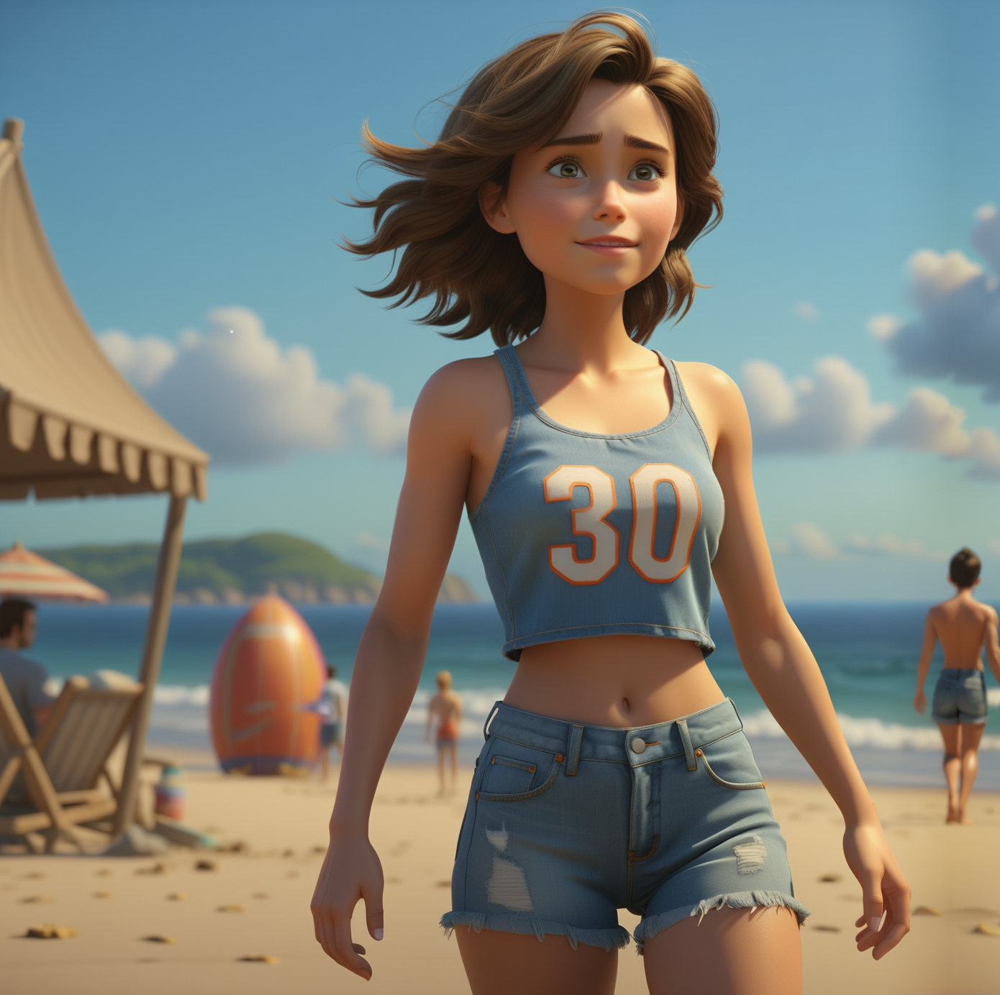

In [22]:
style_images[4]

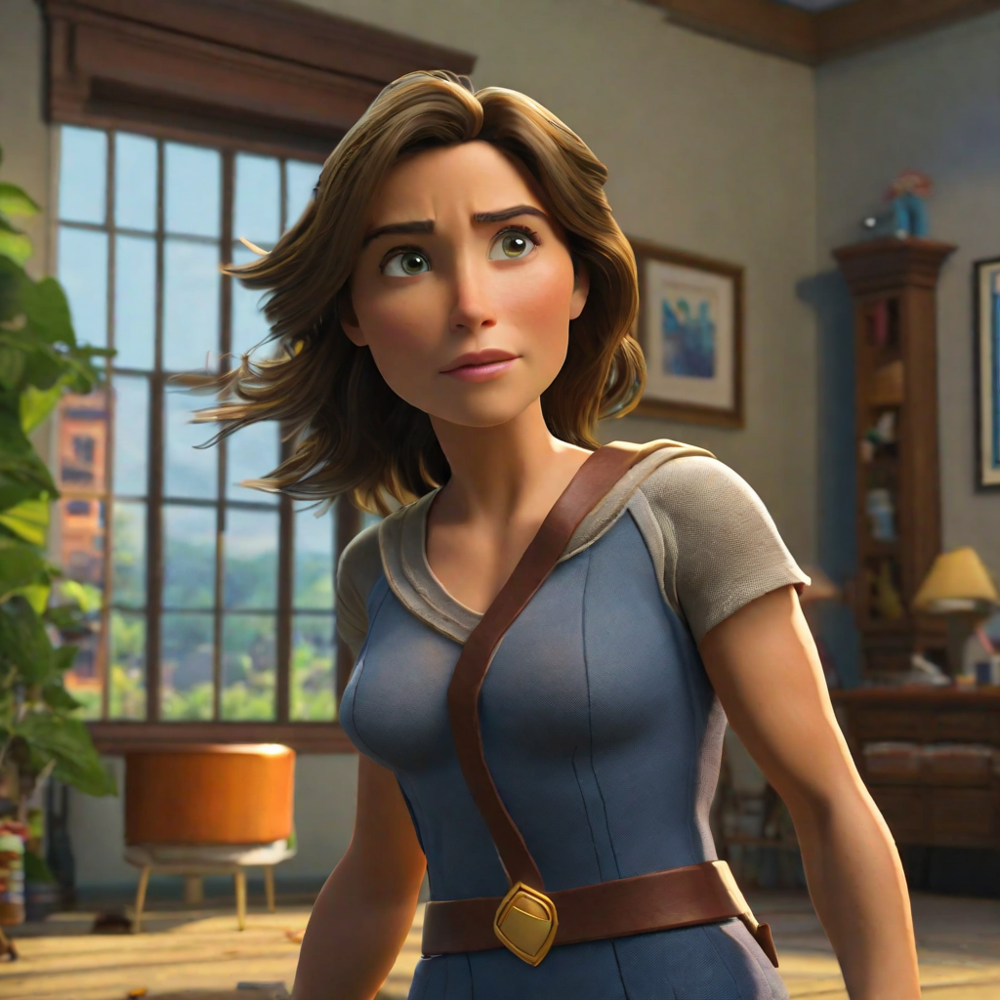

In [19]:
image

diffusion_pytorch_model.safetensors: 100%|██████████| 1.45G/1.45G [04:28<00:00, 5.39MB/s]
100%|██████████| 50/50 [00:11<00:00,  4.34it/s]


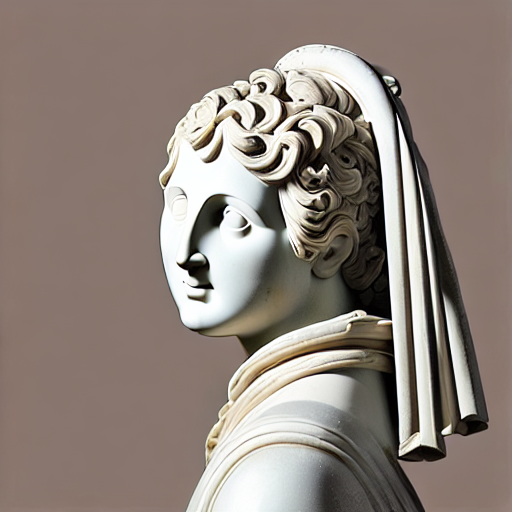

In [25]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel
import torch
from diffusers.utils import load_image

controlnet_model_path = "lllyasviel/control_v11f1p_sd15_depth"
controlnet = ControlNetModel.from_pretrained(controlnet_model_path, torch_dtype=torch.float16)

pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16)
pipeline.to("cuda")

image = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/statue.png")
depth_map = load_image("https://huggingface.co/datasets/YiYiXu/testing-images/resolve/main/depth.png")

pipeline.load_ip_adapter("h94/IP-Adapter", subfolder="models", weight_name="ip-adapter_sd15.bin")

generator = torch.Generator(device="cpu").manual_seed(33)
images = pipeline(
    prompt='best quality, high quality', 
    image=depth_map,
    ip_adapter_image=image,
    negative_prompt="monochrome, lowres, bad anatomy, worst quality, low quality", 
    num_inference_steps=50,
    generator=generator,
).images
images[0]

In [1]:
# animate diff + ip adapter
import torch
from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif, load_image

# Load the motion adapter
adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2", torch_dtype=torch.float16)
# load SD 1.5 based finetuned model
model_id = "Lykon/DreamShaper"
pipe = AnimateDiffPipeline.from_pretrained(model_id, motion_adapter=adapter, torch_dtype=torch.float16)

# scheduler
scheduler = DDIMScheduler(
    clip_sample=False,
    beta_start=0.00085,
    beta_end=0.012,
    beta_schedule="linear",
    timestep_spacing="trailing",
    steps_offset=1
)
pipe.scheduler = scheduler

# enable memory savings
pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

# load ip_adapter
pipe.load_ip_adapter("h94/IP-Adapter", subfolder="models", weight_name="ip-adapter_sd15.bin")

# load motion adapters
pipe.load_lora_weights("guoyww/animatediff-motion-lora-zoom-out", adapter_name="zoom-out")
pipe.load_lora_weights("guoyww/animatediff-motion-lora-tilt-up", adapter_name="tilt-up")
pipe.load_lora_weights("guoyww/animatediff-motion-lora-pan-left", adapter_name="pan-left")

seed = 42
image = load_image("https://user-images.githubusercontent.com/24734142/266492875-2d50d223-8475-44f0-a7c6-08b51cb53572.png")
images = [image] * 3
prompts = ["best quality, high quality"] * 3
negative_prompt = "bad quality, worst quality"
adapter_weights = [[0.75, 0.0, 0.0], [0.0, 0.0, 0.75], [0.0, 0.75, 0.75]]

# generate
output_frames = []
for prompt, image, adapter_weight in zip(prompts, images, adapter_weights):
    pipe.set_adapters(["zoom-out", "tilt-up", "pan-left"], adapter_weights=adapter_weight)
    output = pipe(
      prompt= prompt,
      num_frames=16,
      guidance_scale=7.5,
      num_inference_steps=30,
      ip_adapter_image = image,
      generator=torch.Generator("cpu").manual_seed(seed),
    )
    frames = output.frames[0]
    output_frames.extend(frames)

export_to_gif(output_frames, "test_out_animation.gif") 

C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please v

AttributeError: 'list' object has no attribute 'to'

from : https://huggingface.co/docs/diffusers/en/api/pipelines/animatediff

In [1]:
import torch
from diffusers import AnimateDiffPipeline, DDIMScheduler, MotionAdapter
from diffusers.utils import export_to_gif

# Load the motion adapter
adapter = MotionAdapter.from_pretrained("guoyww/animatediff-motion-adapter-v1-5-2", torch_dtype=torch.float16)
# load SD 1.5 based finetuned model
model_id = "SG161222/Realistic_Vision_V5.1_noVAE"
pipe = AnimateDiffPipeline.from_pretrained(model_id, motion_adapter=adapter, torch_dtype=torch.float16)
scheduler = DDIMScheduler.from_pretrained(
    model_id,
    subfolder="scheduler",
    clip_sample=False,
    timestep_spacing="linspace",
    beta_schedule="linear",
    steps_offset=1,
)
pipe.scheduler = scheduler

# enable memory savings
pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

output = pipe(
    prompt=(
        "masterpiece, bestquality, highlydetailed, ultradetailed, sunset, "
        "orange sky, warm lighting, fishing boats, ocean waves seagulls, "
        "rippling water, wharf, silhouette, serene atmosphere, dusk, evening glow, "
        "golden hour, coastal landscape, seaside scenery"
    ),
    negative_prompt="bad quality, worse quality",
    num_frames=16,
    guidance_scale=7.5,
    num_inference_steps=25,
    generator=torch.Generator("cpu").manual_seed(42),
)
frames = output.frames[0]
export_to_gif(frames, "animation.gif")


C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\Users\Zeki\anaconda3\envs\stable_diff\lib\site-packages\diffusers\utils\outputs.py:63: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please v

'animation.gif'

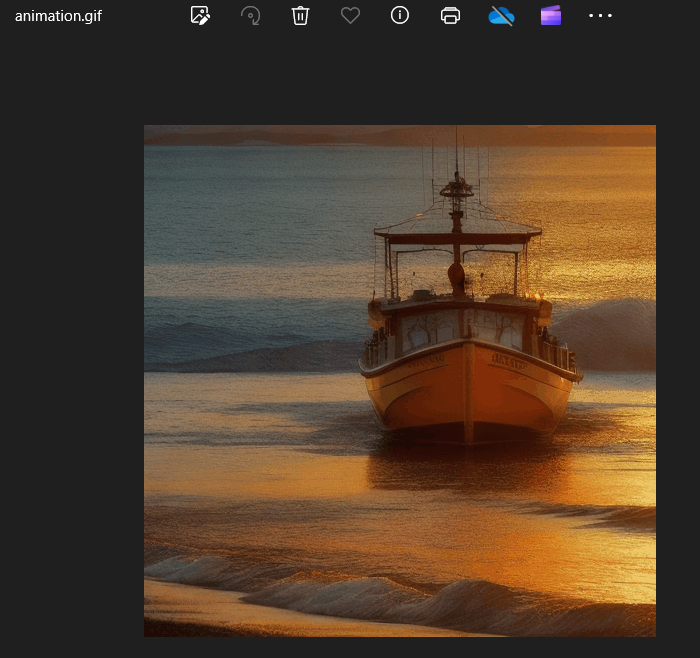